In [1]:
import anndata
import spaco

import scanpy as sc

import matplotlib
import seaborn as sns

import numpy as np
import pandas as pd
import random

import scipy.stats as stats

import matplotlib.pyplot as plt

from skimage import color
from spaco.utils import hex_to_rgb, lab_to_hex

In [2]:
adata_cellbin = anndata.read("../../data/imputation_well05.h5ad")
spatial = pd.read_csv("../../data/well05_spatial.csv", index_col=0).iloc[1:,:]
adata_cellbin.obs = spatial.copy()
adata_cellbin.obsm['spatial'] = np.array(spatial.iloc[:,0:2].astype(float))

adata_cellbin.obs['annotation'] = adata_cellbin.obs['Main_molecular_cell_type'].copy()

In [3]:
min_cells=10
unique_tmp = np.unique(adata_cellbin.obs['annotation'],return_counts=True)
adata_cellbin = adata_cellbin[adata_cellbin.obs['annotation'].isin(unique_tmp[0][unique_tmp[1]>min_cells])].copy()

adata_cellbin = adata_cellbin[adata_cellbin.obs['annotation']!="Unannotated"].copy()

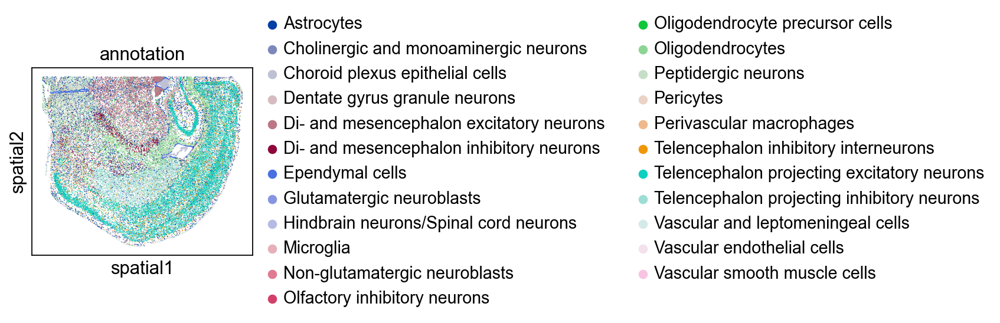

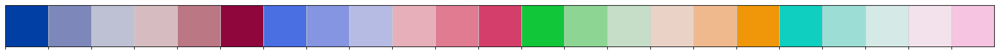

In [4]:
#--- cell_bin data
adata_cellbin.obs['annotation'] = adata_cellbin.obs['annotation'].astype(str).astype('category')

# Default colorization
sc.set_figure_params(figsize=(3,6), facecolor="white", dpi_save=300)
sc.pl.spatial(adata_cellbin, color="annotation", spot_size=135)

# Get the above (default) color palette
palette_default = adata_cellbin.uns['annotation_colors'].copy()
sns.palplot(palette_default)

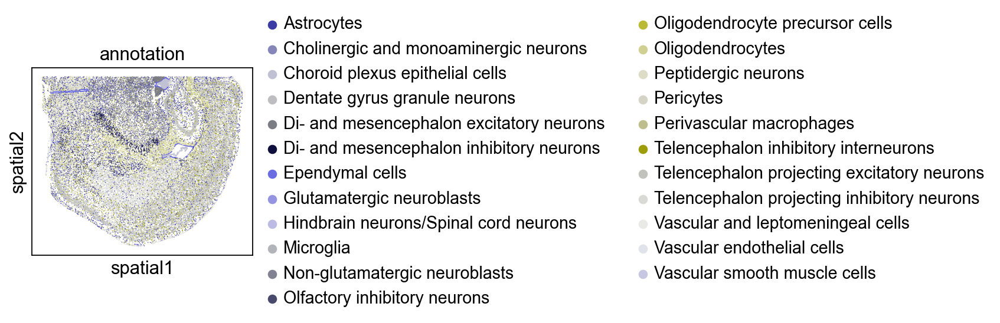

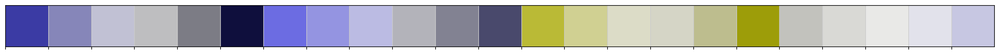

In [5]:
palette_default_simu = spaco.utils.simulate_cvd(
    np.array(palette_default),
    colorblind_type='protanopia'
)
sc.pl.spatial(adata_cellbin, color="annotation", spot_size=135, palette=palette_default_simu, save="Figure_scanpy_simu.pdf")
sns.palplot(palette_default_simu)

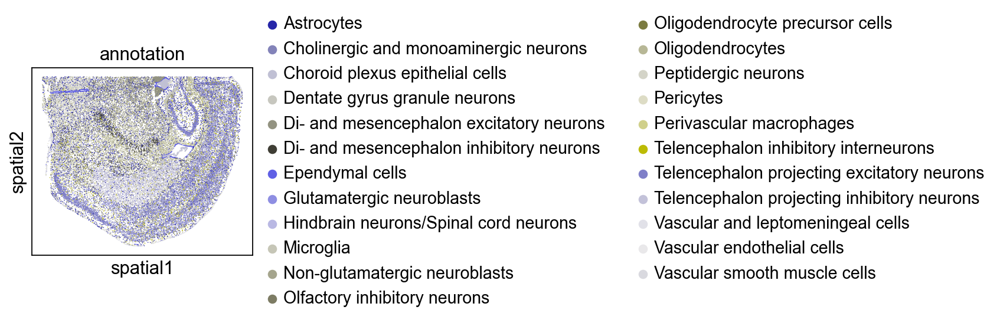

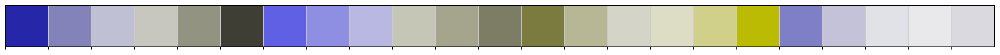

In [6]:
palette_default_simu = spaco.utils.simulate_cvd(
    np.array(palette_default),
    colorblind_type='deuteranopia'
)
sc.pl.spatial(adata_cellbin, color="annotation", spot_size=135, palette=palette_default_simu, save="Figure_spaco.pdf")
sns.palplot(palette_default_simu)

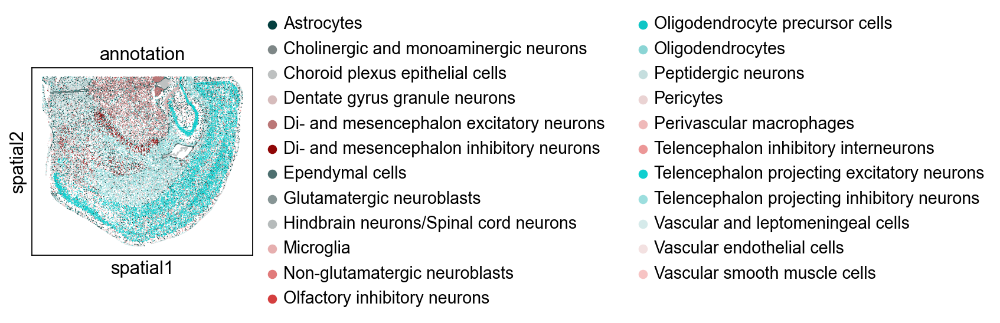

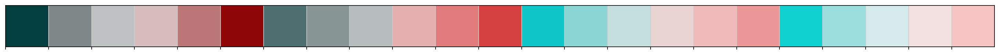

In [7]:
palette_default_simu = spaco.utils.simulate_cvd(
    np.array(palette_default),
    colorblind_type='tritanopia'
)
sc.pl.spatial(adata_cellbin, color="annotation", spot_size=135, palette=palette_default_simu)#, save="Figure_spaco.pdf")
sns.palplot(palette_default_simu)

## gCVD support for Spaco assignment

In [8]:
cig_graph = spaco.distance.spatial_distance(
    cell_coordinates=adata_cellbin.obsm['spatial'],
    cell_labels=adata_cellbin.obs['annotation'],
    radius=200,
    n_neighbors=30,
    n_cells=3,
)

cig_graph_tmp = cig_graph.copy()
cig_graph_tmp['index'] = cig_graph_tmp.index
#cig_graph_tmp.melt(id_vars=['index']).to_csv("cig.csv")

|-----------> Calculating cell neighborhood...
|-----------> Filtering out neighborhood outliers...
|-----------> Calculating cluster interlacement score...
|-----------> Constructing cluster interlacement graph...


|-----------> Calculating color perceptual distance under general...
|-----------> Constructing color distance graph...


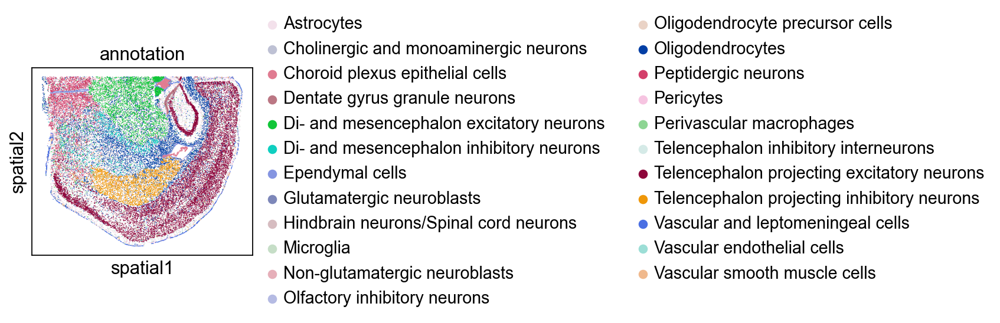

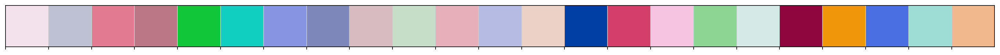

In [13]:
color_mapping = spaco.mapping.map_graph(
    cig_graph,
    spaco.distance.perceptual_distance(palette_default, colorblind_type="general"), 
    distance_metric="mul_1",
    random_max_iter=5000,
)

color_mapping = {k: color_mapping[k] for k in adata_cellbin.obs['annotation'].cat.categories}

# Set new colors for adata
palette_spaco = list(color_mapping.values())

# Spaco colorization
sc.pl.spatial(adata_cellbin, color="annotation", spot_size=135, palette=palette_spaco, save="Figure_spaco.pdf")
sns.palplot(palette_spaco)

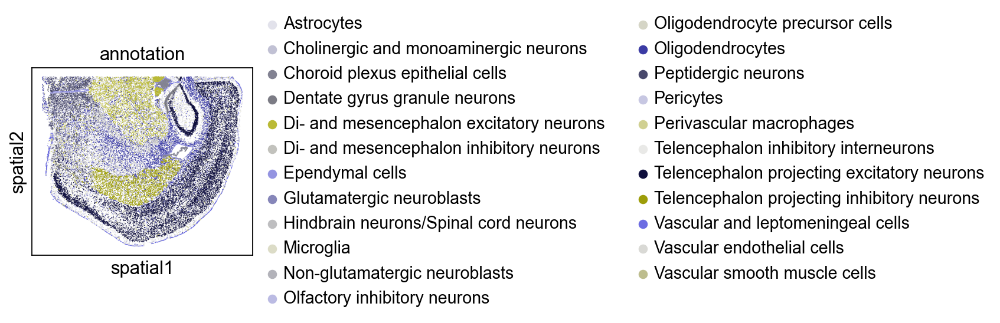

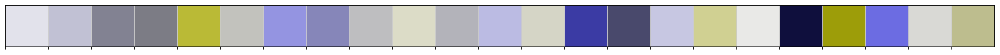

In [10]:
cvd_type = 'protanopia'

palette_spaco_simu = spaco.utils.simulate_cvd(
    np.array(palette_spaco),
    colorblind_type=cvd_type
)
sc.pl.spatial(adata_cellbin, color="annotation", spot_size=135, palette=palette_spaco_simu, save=f"Figure_{cvd_type}_spaco_simu.pdf")
sns.palplot(palette_spaco_simu)

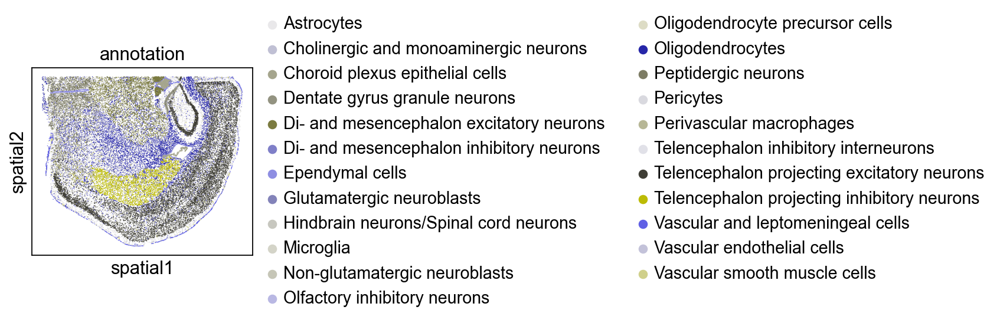

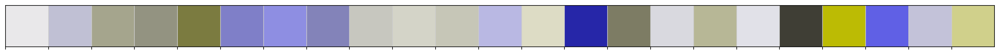

In [11]:
cvd_type = 'deuteranopia'

palette_spaco_simu = spaco.utils.simulate_cvd(
    np.array(palette_spaco),
    colorblind_type=cvd_type
)
sc.pl.spatial(adata_cellbin, color="annotation", spot_size=135, palette=palette_spaco_simu, save=f"Figure_{cvd_type}_spaco_simu.pdf")
sns.palplot(palette_spaco_simu)

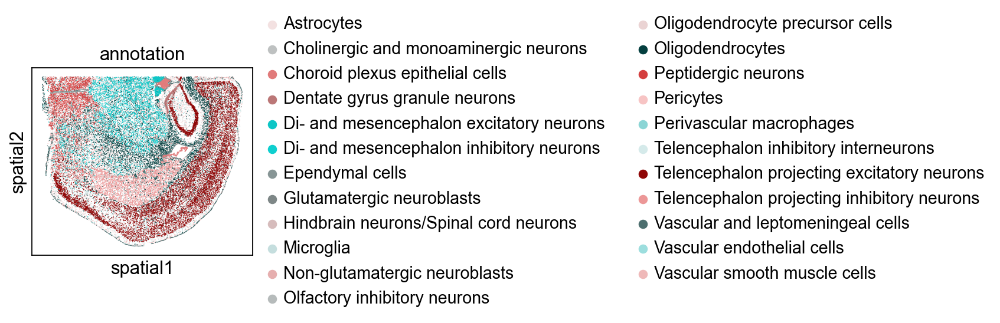

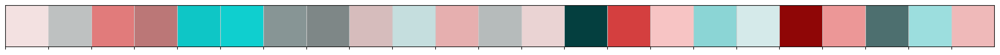

In [12]:
cvd_type = 'tritanopia'

palette_spaco_simu = spaco.utils.simulate_cvd(
    np.array(palette_spaco),
    colorblind_type=cvd_type
)
sc.pl.spatial(adata_cellbin, color="annotation", spot_size=135, palette=palette_spaco_simu, save=f"Figure_{cvd_type}_spaco_simu.pdf")
sns.palplot(palette_spaco_simu)

## Specific type of CVD support for Spaco assignment

In [15]:
# Separately test for each CVD, for daily use for specific people
def cvd_test(cvd_type = 'protanopia'):
    color_mapping = spaco.mapping.map_graph(cig_graph,spaco.distance.perceptual_distance(palette_default,colorblind_type=cvd_type), 
                                        distance_metric="mul_1", random_max_iter=5000)

    color_mapping = {k: color_mapping[k] for k in adata_cellbin.obs['annotation'].cat.categories}
    
    # Set new colors for adata
    palette_spaco = list(color_mapping.values())

    palette_default_simu = spaco.utils.simulate_cvd(
        np.array(palette_default),
        colorblind_type=cvd_type
    )
    sc.pl.spatial(adata_cellbin, color="annotation", spot_size=135, palette=palette_default_simu, save=f"Figure_{cvd_type}_scanpy_simu.pdf")
    sns.palplot(palette_default_simu)

    # Spaco colorization
    sc.pl.spatial(adata_cellbin, color="annotation", spot_size=135, palette=palette_spaco, save=f"Figure_{cvd_type}_spaco.pdf")
    sns.palplot(palette_spaco)
    
    palette_spaco_simu = spaco.utils.simulate_cvd(
        np.array(palette_spaco),
        colorblind_type=cvd_type
    )
    sc.pl.spatial(adata_cellbin, color="annotation", spot_size=135, palette=palette_spaco_simu, save=f"Figure_{cvd_type}_spaco_simu.pdf")
    sns.palplot(palette_spaco_simu)

|-----------> Calculating color perceptual distance under protanopia...
|-----------> Constructing color distance graph...


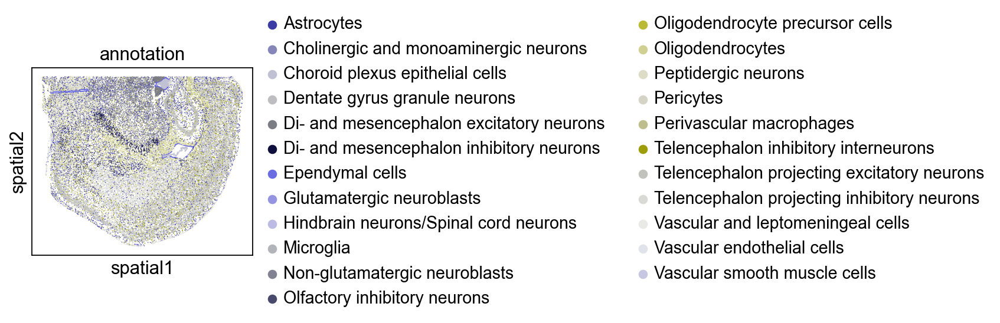

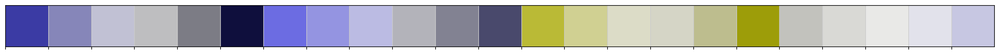

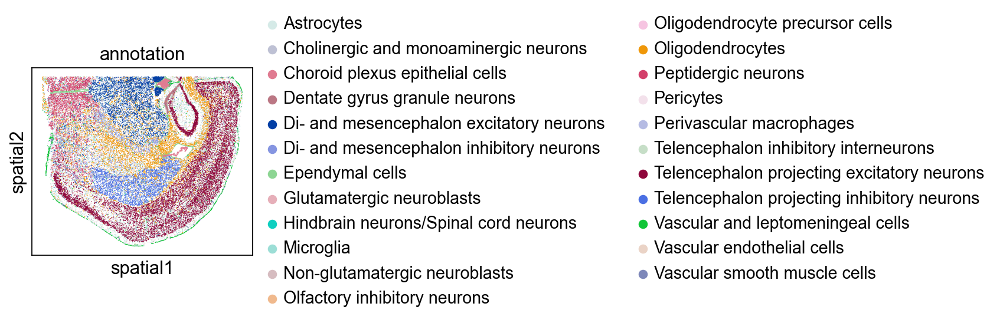

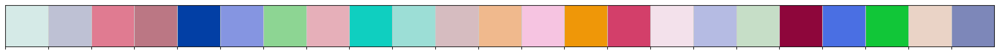

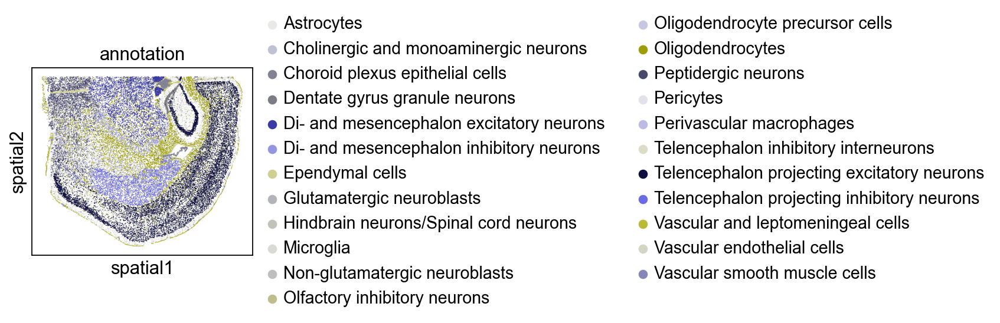

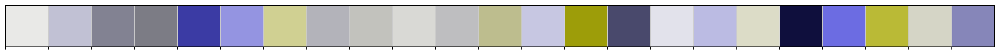

In [16]:
cvd_test(cvd_type = 'protanopia')

|-----------> Calculating color perceptual distance under deuteranopia...
|-----------> Constructing color distance graph...


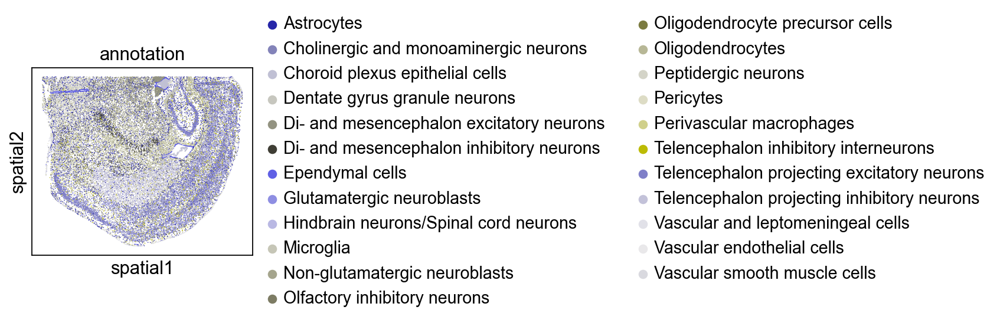

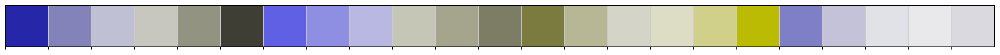

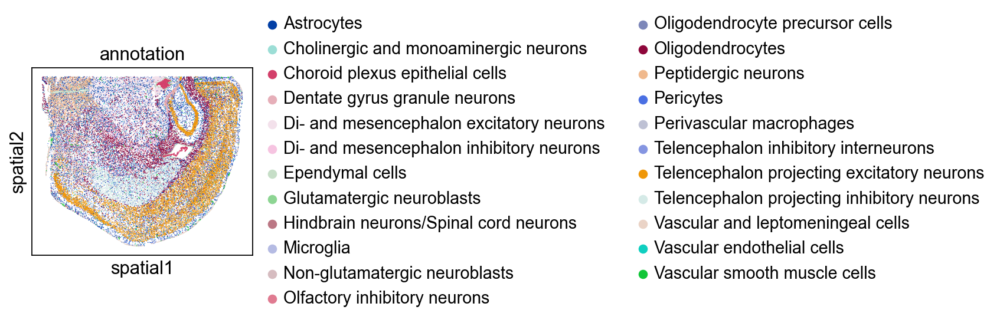

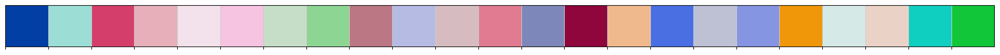

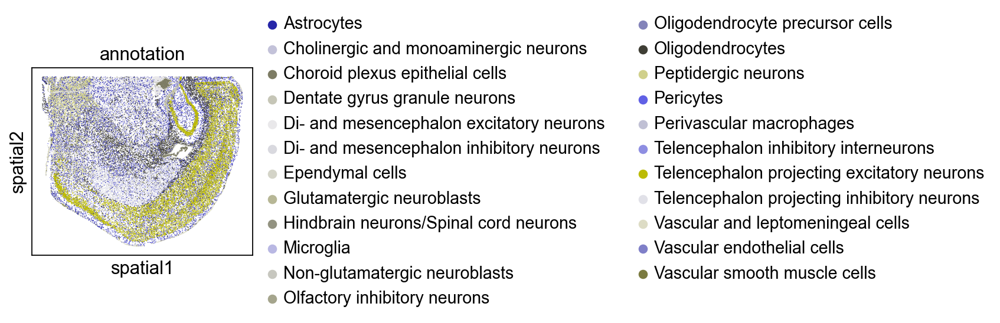

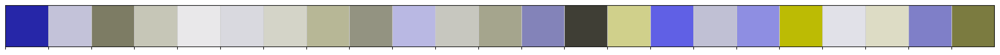

In [17]:
cvd_test(cvd_type = 'deuteranopia')

|-----------> Calculating color perceptual distance under tritanopia...
|-----------> Constructing color distance graph...


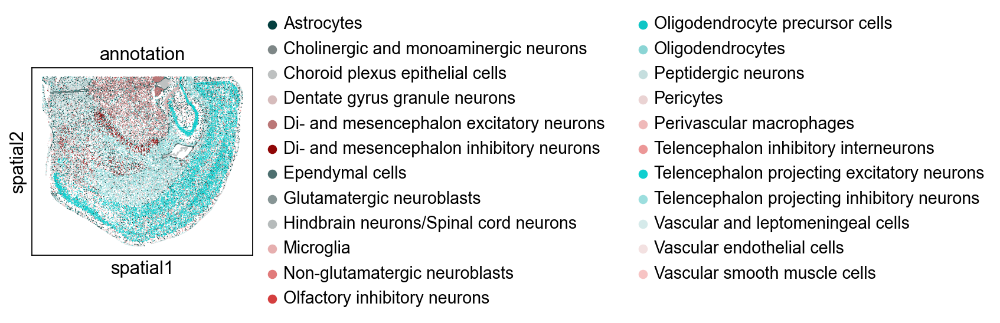

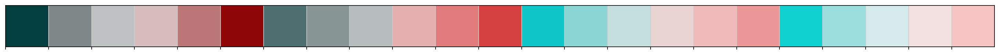

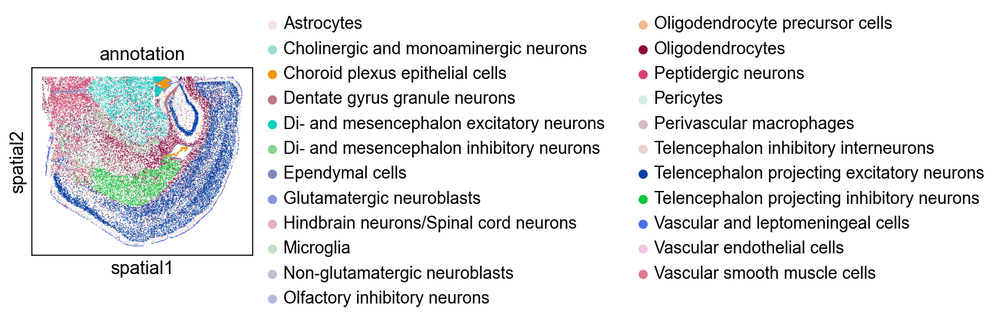

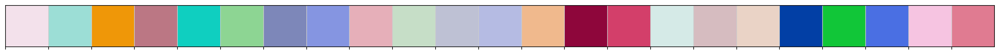

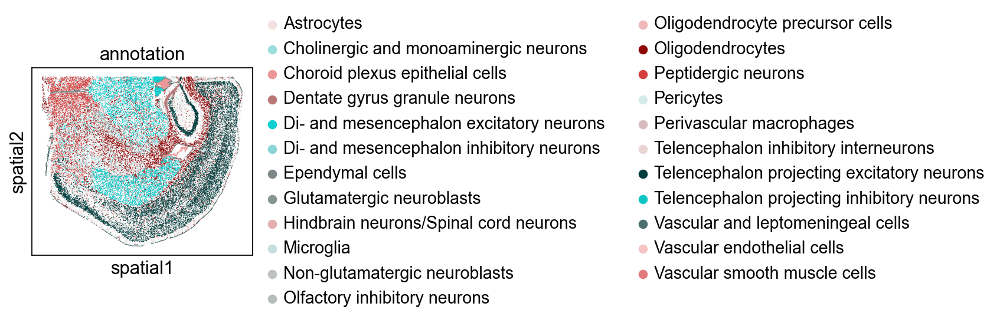

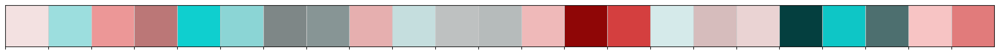

In [18]:
cvd_test(cvd_type = 'tritanopia')

# Image-guided

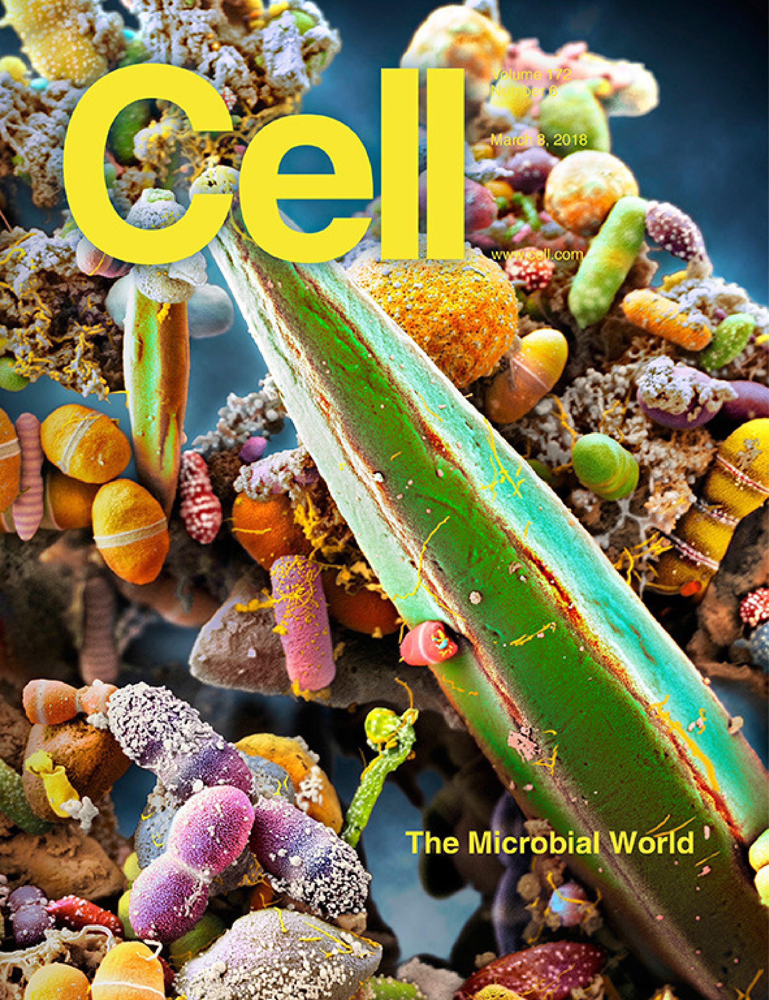

In [14]:
from PIL import Image

#img = Image.open("./figures/abc.jpg").convert("RGB")
img = Image.open("/DATA/User/yangbolin/04.data/03.spaco/cell_picture1.jpg").convert("RGB")
img

In [15]:
adata_cellbin = anndata.read("/DATA/User/jingzh/02.Projects/spatial_coloring/data/10DPI_1_left.h5ad")

adata_cellbin.obs['annotation'] = adata_cellbin.obs['Annotation'].copy()

In [16]:
adata_cellbin.obs.head()

,CellID,spatial_leiden_e30_s8,Batch,cell_id,seurat_clusters,inj_uninj,D_V,inj_M_L,Annotation,annotation
CELL.17879,CELL.17879,2,Injury_10DPI_rep1_SS200000147BL_B5,17879,3,uninj,V,NO,VLMC,VLMC
CELL.17922,CELL.17922,2,Injury_10DPI_rep1_SS200000147BL_B5,17922,3,uninj,V,NO,VLMC,VLMC
CELL.17927,CELL.17927,2,Injury_10DPI_rep1_SS200000147BL_B5,17927,5,uninj,D,NO,VLMC,VLMC
CELL.17937,CELL.17937,6,Injury_10DPI_rep1_SS200000147BL_B5,17937,5,uninj,D,NO,VLMC,VLMC
CELL.17952,CELL.17952,2,Injury_10DPI_rep1_SS200000147BL_B5,17952,5,uninj,V,NO,VLMC,VLMC


## Filter cells

In [17]:
min_cells=10
unique_tmp = np.unique(adata_cellbin.obs['annotation'],return_counts=True)
adata_cellbin = adata_cellbin[adata_cellbin.obs['annotation'].isin(unique_tmp[0][unique_tmp[1]>min_cells])].copy()

adata_cellbin = adata_cellbin[adata_cellbin.obs['annotation']!="Unannotated"].copy()

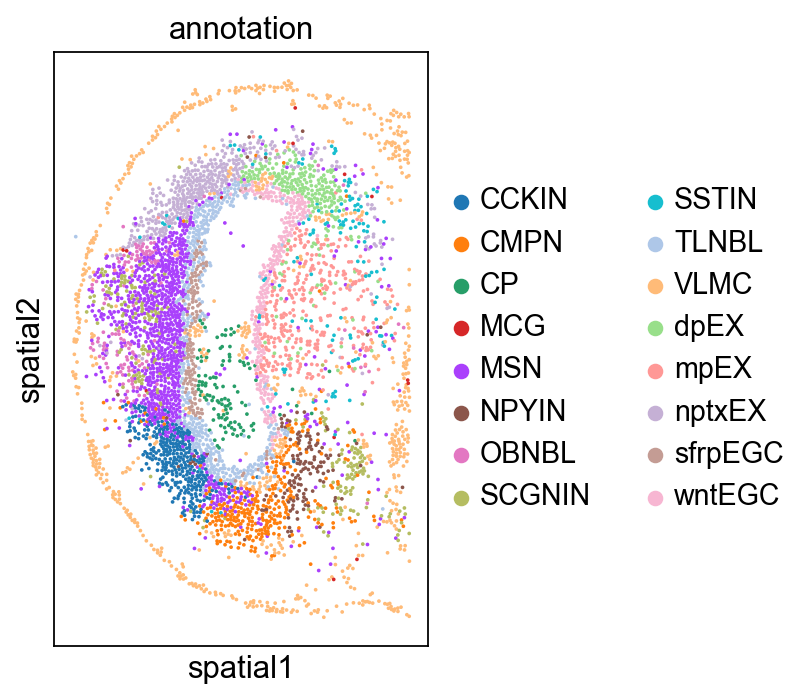

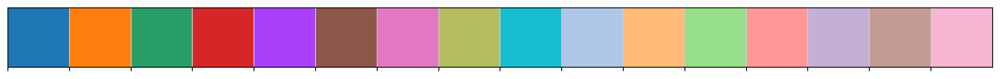

In [18]:
#--- cell_bin data
adata_cellbin.obs['annotation'] = adata_cellbin.obs['annotation'].astype(str).astype('category')

# Default colorization
sc.set_figure_params(figsize=(3,6), facecolor="white", dpi_save=300)
sc.pl.spatial(adata_cellbin, color="annotation", spot_size=35)

# Get the above (default) color palette
palette_default = adata_cellbin.uns['annotation_colors'].copy()
sns.palplot(palette_default)

## gCVD support for Spaco palette extraction

In [19]:
cig_graph = spaco.distance.spatial_distance(
    cell_coordinates=adata_cellbin.obsm['spatial'],
    cell_labels=adata_cellbin.obs['annotation'],
    radius=120,
    n_neighbors=35,
    n_cells=3,
)

|-----------> Calculating cell neighborhood...
|-----------> Filtering out neighborhood outliers...
|-----------> Calculating cluster interlacement score...
|-----------> Constructing cluster interlacement graph...


|-----------------> Extracting color bins...
|-----------------> Initiating palette...
|-----------------> Optimizing extracted palette...
|-----------> Calculating color perceptual distance under general...
|-----------> Constructing color distance graph...


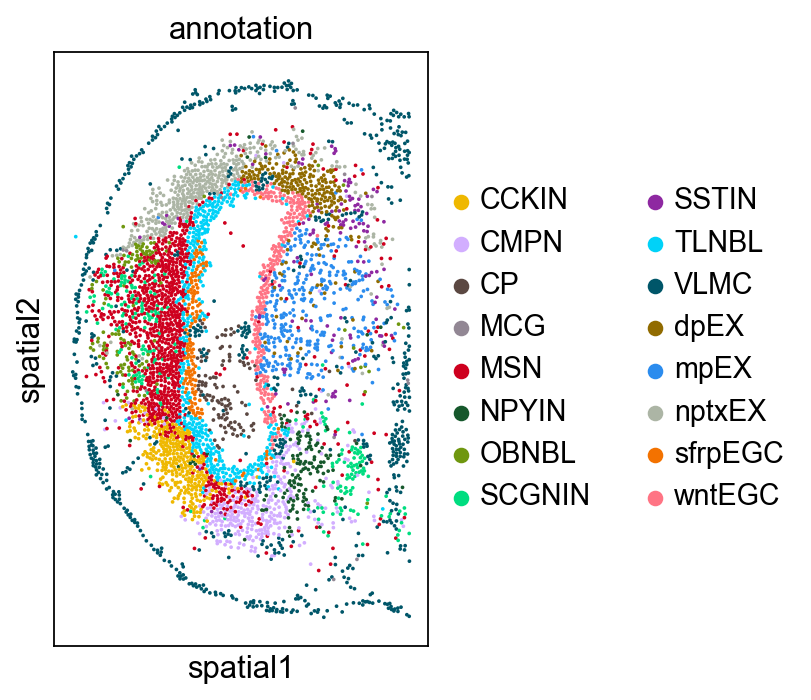

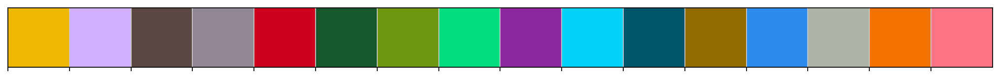

In [20]:
palette_img = spaco.utils.extract_palette(reference_image=img,n_colors=len(palette_default),l_range=(30,80),colorblind_type="general")

color_mapping = spaco.mapping.map_graph(cig_graph,spaco.distance.perceptual_distance(palette_img,colorblind_type="general"), 
                                        distance_metric="mul_1", random_max_iter=5000)

color_mapping = {k: color_mapping[k] for k in adata_cellbin.obs['annotation'].cat.categories}

# Set new colors for adata
palette_img = list(color_mapping.values())

# Spaco colorization
sc.pl.spatial(adata_cellbin, color="annotation", spot_size=35, palette=palette_img,save=f"Fig.DPI_gCVD_spaco.pdf")
sns.palplot(palette_img)

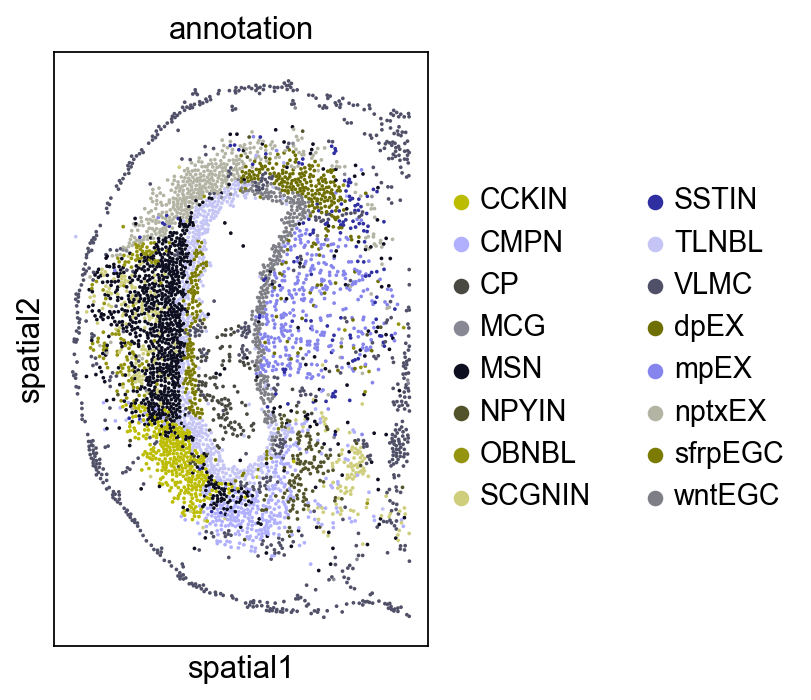

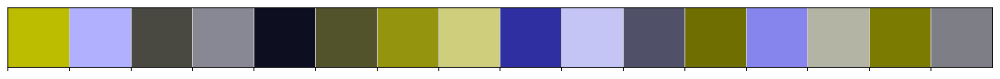

In [21]:
cvd_type = 'protanopia'

palette_img_simu = spaco.utils.simulate_cvd(
    np.array(palette_img),
    colorblind_type=cvd_type
)
sc.pl.spatial(adata_cellbin, color="annotation", spot_size=35, palette=palette_img_simu, save=f"Fig.DPI_{cvd_type}_simu.pdf")
sns.palplot(palette_img_simu)

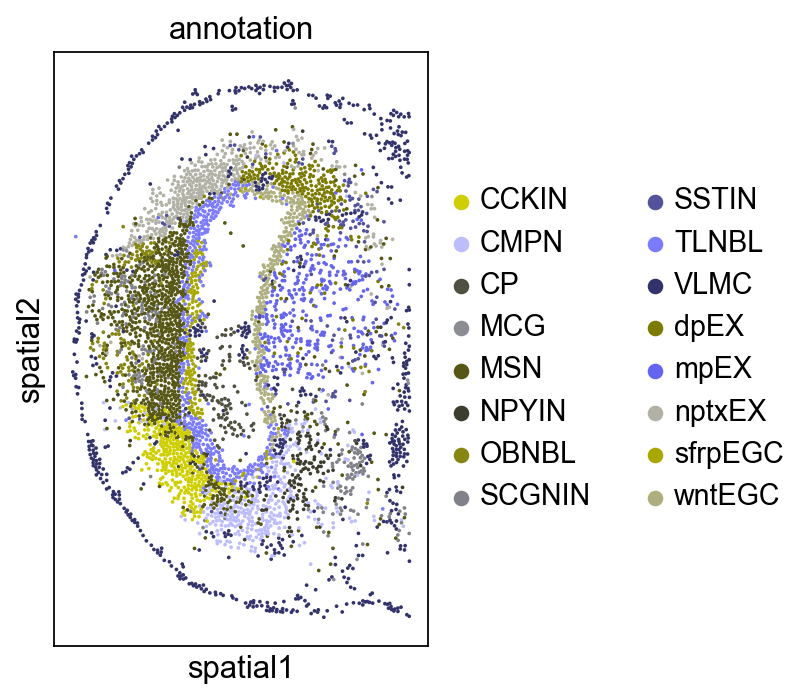

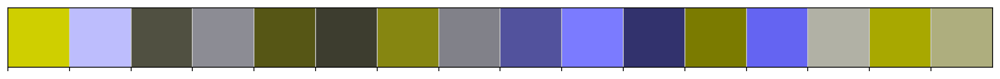

In [22]:
cvd_type = 'deuteranopia'

palette_img_simu = spaco.utils.simulate_cvd(
    np.array(palette_img),
    colorblind_type=cvd_type
)
sc.pl.spatial(adata_cellbin, color="annotation", spot_size=35, palette=palette_img_simu, save=f"Fig.DPI_{cvd_type}_simu.pdf")
sns.palplot(palette_img_simu)

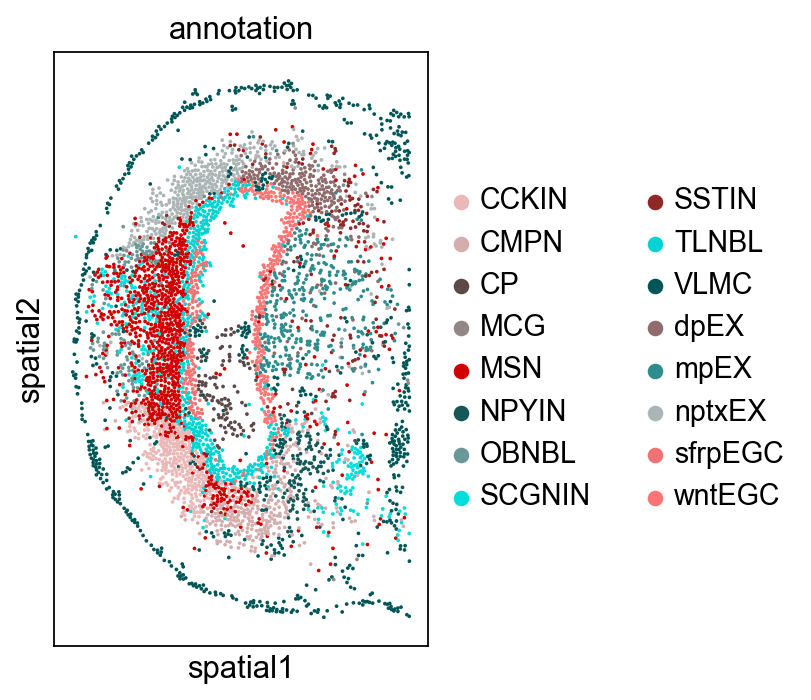

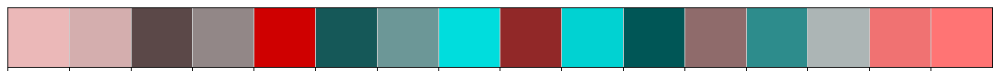

In [23]:
cvd_type = 'tritanopia'

palette_img_simu = spaco.utils.simulate_cvd(
    np.array(palette_img),
    colorblind_type=cvd_type
)
sc.pl.spatial(adata_cellbin, color="annotation", spot_size=35, palette=palette_img_simu, save=f"Fig.DPI_{cvd_type}_simu.pdf")
sns.palplot(palette_img_simu)

## Specific type of CVD support for Spaco palette extraction

In [8]:
# Separately test for each CVD, for daily use for specific people
def cvd_test_img_pal(cvd_type = 'protanopia'):
    palette_img = spaco.utils.extract_palette(reference_image=img,n_colors=len(palette_default),l_range=(30,80),colorblind_type=cvd_type)
    
    color_mapping = spaco.mapping.map_graph(cig_graph,spaco.distance.perceptual_distance(palette_img,colorblind_type=cvd_type), 
                                            distance_metric="mul_1", random_max_iter=5000)
    
    color_mapping = {k: color_mapping[k] for k in adata_cellbin.obs['annotation'].cat.categories}
    
    # Set new colors for adata
    palette_img = list(color_mapping.values())
    
    # Spaco colorization
    sc.pl.spatial(adata_cellbin, color="annotation", spot_size=35, palette=palette_img,save=f"Fig.DPI_{cvd_type}_spaco.pdf")
    sns.palplot(palette_img)
    palette_img_simu = spaco.utils.simulate_cvd(
        np.array(palette_img),
        colorblind_type=cvd_type
    )
    sc.pl.spatial(adata_cellbin, color="annotation", spot_size=35, palette=palette_img_simu, save=f"Fig.DPI_{cvd_type}_simu.pdf")
    sns.palplot(palette_img_simu)

|-----------------> Extracting color bins...
|-----------------> Initiating palette...
|-----------------> Optimizing extracted palette...
|-----------> Calculating color perceptual distance under protanopia...
|-----------> Constructing color distance graph...


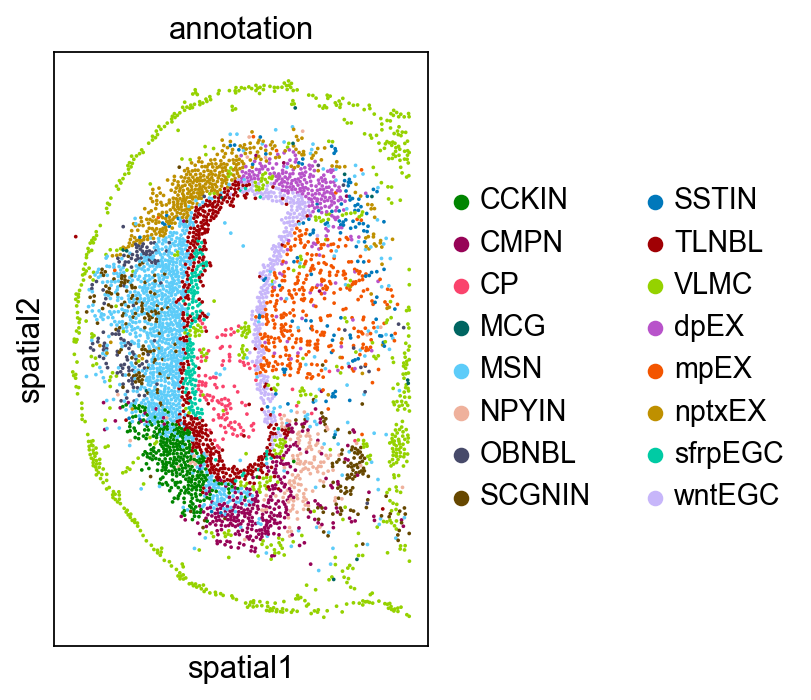

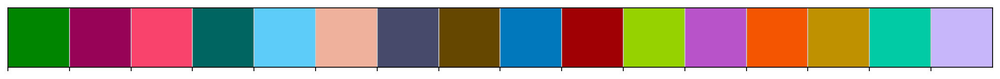

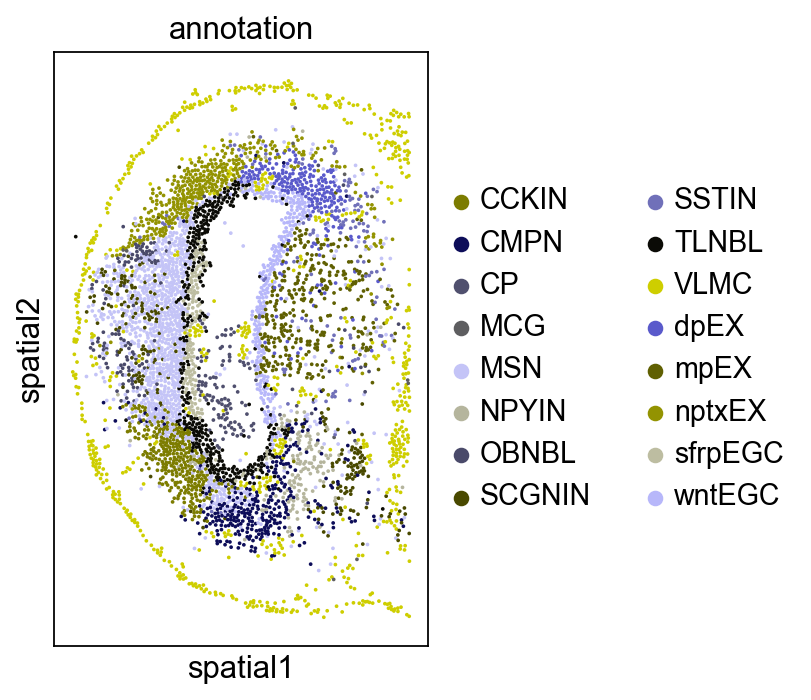

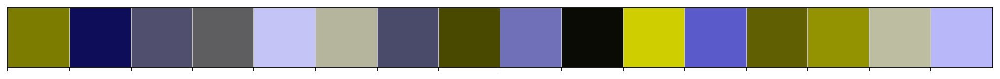

In [11]:
cvd_test_img_pal('protanopia')

|-----------------> Extracting color bins...
|-----------------> Initiating palette...
|-----------------> Optimizing extracted palette...
|-----------> Calculating color perceptual distance under deuteranopia...
|-----------> Constructing color distance graph...


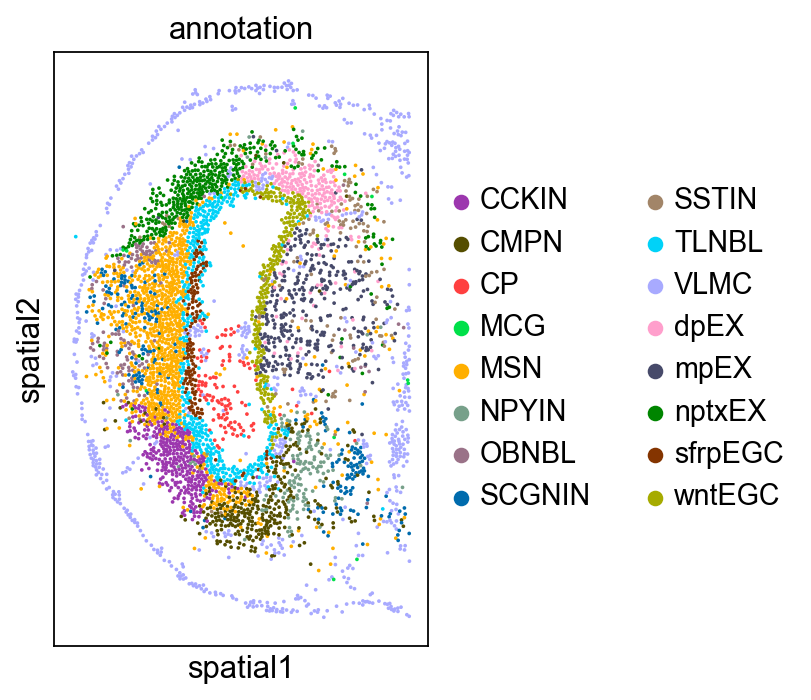

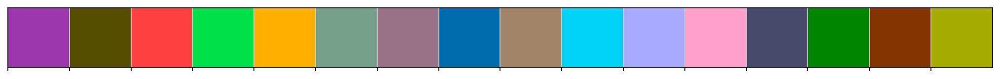

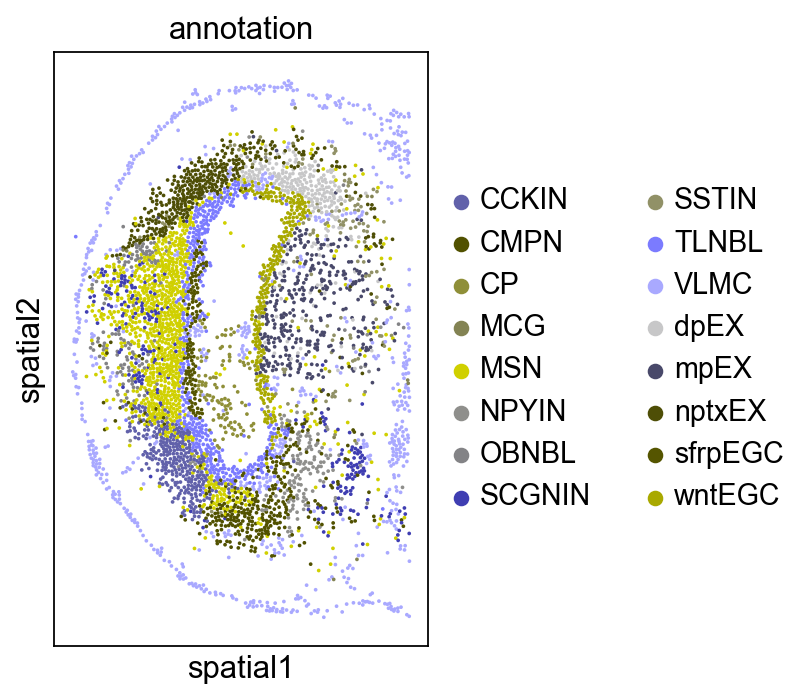

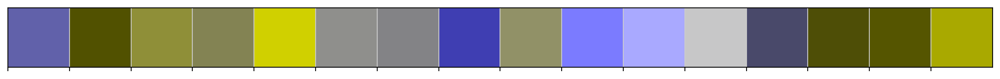

In [12]:
cvd_test_img_pal('deuteranopia')

|-----------------> Extracting color bins...
|-----------------> Initiating palette...
|-----------------> Optimizing extracted palette...
|-----------> Calculating color perceptual distance under tritanopia...
|-----------> Constructing color distance graph...


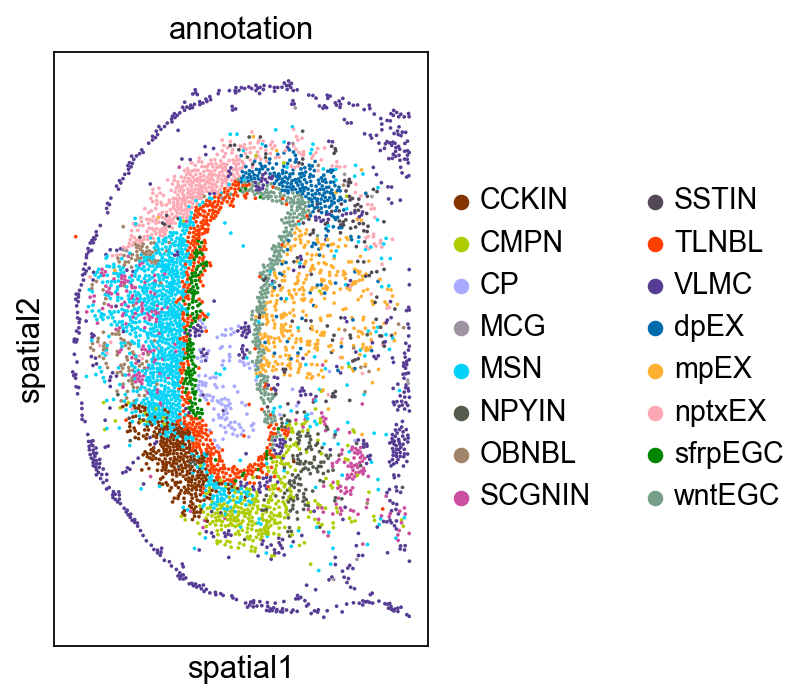

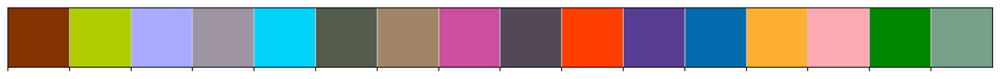

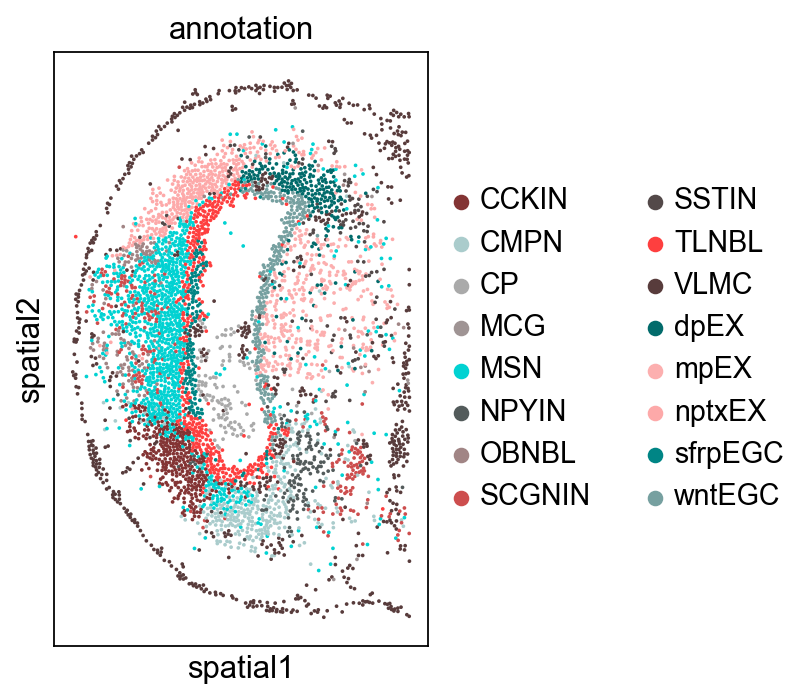

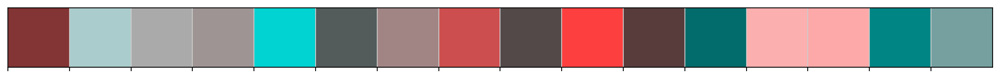

In [14]:
cvd_test_img_pal(cvd_type = 'tritanopia')

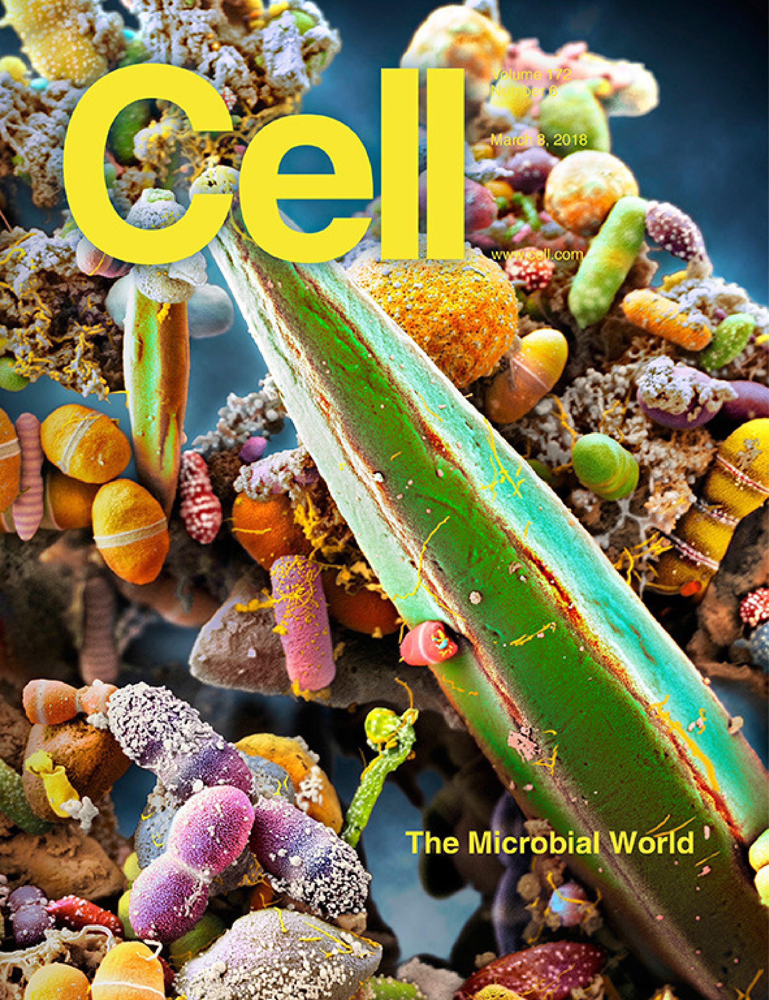

In [2]:
from PIL import Image

#img = Image.open("./figures/abc.jpg").convert("RGB")
img = Image.open("/DATA/User/yangbolin/04.data/03.spaco/cell_picture1.jpg").convert("RGB")
img

In [17]:
from colorblind import colorblind

(-0.5, 2462.5, 3199.5, -0.5)

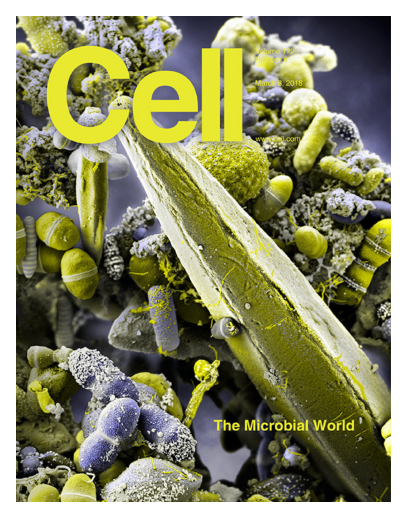

In [22]:

plt.imshow(colorblind.simulate_colorblindness(np.array(img), colorblind_type='protanopia'))
plt.grid(visible=False)
plt.axis('off')

(-0.5, 2462.5, 3199.5, -0.5)

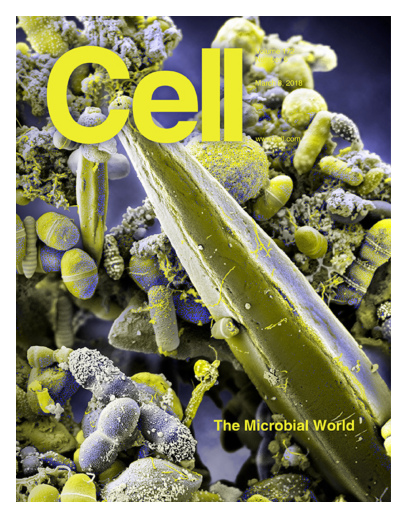

In [23]:

plt.imshow(colorblind.simulate_colorblindness(np.array(img), colorblind_type='deuteranopia'))
plt.grid(visible=False)
plt.axis('off')

(-0.5, 2462.5, 3199.5, -0.5)

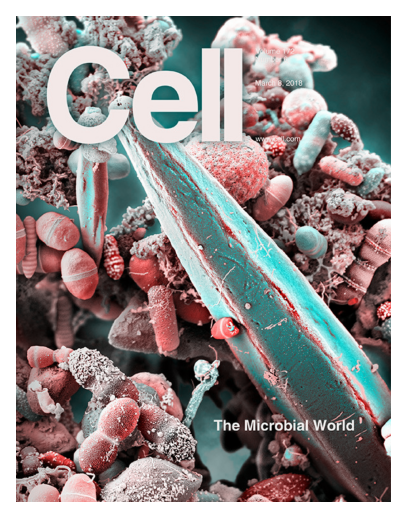

In [24]:

plt.imshow(colorblind.simulate_colorblindness(np.array(img), colorblind_type='tritanopia'))
plt.grid(visible=False)
plt.axis('off')

In [25]:
import session_info


session_info.show(excludes=['base'])